<H1>Multivariate prediction of difference in flows</h1>

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.discriminant_analysis import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
import plotly.graph_objects as go
from datetime import datetime
from plotly.subplots import make_subplots
import os

In [2]:
directory_list = [
    os.path.join('..', 'Inputs_outputs_excels', 'wsv_main_exportt.xlsx')
]

df_original = pd.read_excel(directory_list[0])     #This contains the flow.bc (Mass Balance Correction) values

df_mae= df_original

In [3]:
df = df_original[1:]
df_input = df

df.index = pd.to_datetime(df['Date'],format='%d.%m.%Y %H:%M:%S')

input_data=35000

In [4]:
df.columns

Index(['Date', 'WUEOP/level', 'WUEOP/level.bc', 'WUEOP/volume', 'WUEUP/level',
       'WUEUP/level.setpoint', 'WUEUP/volume', 'WUEKW/flow', 'WUEKW/flow.bc',
       'WUEKW/flow.setpoint', 'WUERZ/flow.obs', 'WUEUP_ERLOP/flow',
       'ERLOP/level', 'ERLOP/level.setpoint', 'ERLOP/volume', 'ERLOP/flow.bc',
       'ERLUP/level', 'ERLUP/level.setpoint', 'ERLUP/volume', 'ERLKW/flow',
       'ERLKW/flow.bc', 'ERLKW/flow.setpoint', 'ERLUP_HIMOP/flow',
       'HIMOP/level', 'HIMOP/level.setpoint', 'HIMOP/volume', 'HIMOP/flow.bc',
       'HIMUP/level', 'HIMUP/level.setpoint', 'HIMUP/volume', 'HIMKW/flow',
       'HIMKW/flow.bc', 'HIMKW/flow.setpoint', 'HIMUP_HAROP/flow',
       'HAROP/level', 'HAROP/level.setpoint', 'HAROP/volume', 'HAROP/flow.bc',
       'HARUP/level', 'HARUP/level.setpoint', 'HARUP/volume', 'HARKW/flow',
       'HARKW/flow.bc', 'HARKW/flow.setpoint', 'HARUP_MFRAE/flow',
       'MFRAE/flow.bc', 'MFRAE/flow.setpoint', 'MFRAE/level', 'MFRAE/volume',
       'MFRAE_STEOP/flow', 'STE

<h2>Preprocessing data </h2>

<h2>Create a new timeseries table with lag</h2>

In [5]:
features_for_input=['WUEOP/level.bc',
                    'WUEUP/level.setpoint',
                    'WUEKW/flow.setpoint',
                    'WUERZ/flow.obs',
                    'ERLOP/level.setpoint',
                    'ERLUP/level.setpoint',
                    'ERLKW/flow.setpoint',
                    'HIMOP/level.setpoint',
                    'HIMUP/level.setpoint',
                    'HIMKW/flow.setpoint',
                    'HAROP/level.setpoint',
                    'HARUP/level.setpoint',
                    'HARKW/flow.setpoint',
                    'MFRAE/flow.setpoint',
                    'STEOP/level.setpoint',
                    'STEUP/level.bc',
                    'STEKW/flow.setpoint',
                    'STEIN/flow.obs'
                 ]

<h3>Input data</h3>

In [6]:
df_input=df[features_for_input].reset_index(drop=True)
#df_input=df_input.reset_index(drop=True)

<h3>Adding periodicity for date</h3>

In [7]:
time=df['Date']
df_time=pd.DataFrame({'Date': time})
df_time['Seconds']=df_time.index.map(pd.Timestamp.timestamp)

df_time['Day sin']= np.sin(df_time['Seconds']*(2*np.pi/86400))
df_time['Day cos']= np.cos(df_time['Seconds']*(2*np.pi/86400))
#df_time['Year sin']= np.sin(df_time['Seconds']*(2*np.pi/86400/365.2425))
#df_time['Year cos']= np.cos(df_time['Seconds']*(2*np.pi/86400/365.2425))
df_time=df_time.drop('Date',axis=1)
df_time=df_time.drop('Seconds',axis=1)
df_time=df_time.reset_index(drop=True)

In [8]:
df_input_concatenated=pd.concat([df_time,df_input],axis=1,ignore_index=True)
X_val = df_input_concatenated[input_data:]   #validation dataset

df_input_concatenated=df_input_concatenated[:input_data]

df_input_concatenated


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,0.065403,0.997859,169.003998,167.130997,162.0,291.0,165.917999,162.807007,229.0,161.811005,158.667007,254.0,157.492996,153.953003,269.0,49.200001,152.593002,148.688995,328.0,343.0
1,0.130526,0.991445,169.014008,167.130997,162.0,291.0,165.917999,162.807007,229.0,161.811005,158.686996,254.0,157.492996,153.942993,269.0,49.110001,152.582993,148.688995,328.0,343.0
2,0.195090,0.980785,169.003998,167.130997,162.0,291.0,165.917999,162.807007,229.0,161.820999,158.686996,255.0,157.503006,153.953003,274.0,49.110001,152.582993,148.688995,328.0,343.0
3,0.258819,0.965926,169.014008,167.130997,162.0,289.0,165.917999,162.817001,229.0,161.820999,158.697006,255.0,157.492996,153.953003,277.0,49.110001,152.572998,148.699005,328.0,343.0
4,0.321439,0.946930,169.014008,167.130997,162.0,291.0,165.917999,162.817001,229.0,161.820999,158.697006,255.0,157.503006,153.962997,277.0,49.110001,152.572998,148.688995,328.0,343.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34995,-0.258819,-0.965926,168.684006,166.380997,147.0,158.0,165.807999,162.186996,139.0,161.740997,158.026993,164.0,157.382996,153.302994,148.0,39.779999,152.572998,148.039001,213.0,206.0
34996,-0.321439,-0.946930,168.694000,166.380997,147.0,156.0,165.817993,162.186996,139.0,161.731003,157.996994,164.0,157.382996,153.283005,148.0,39.779999,152.572998,148.048996,213.0,206.0
34997,-0.382683,-0.923880,168.694000,166.391006,148.0,156.0,165.828003,162.186996,139.0,161.710999,157.977005,164.0,157.382996,153.292999,148.0,40.080002,152.582993,148.048996,213.0,206.0
34998,-0.442289,-0.896873,168.694000,166.391006,148.0,158.0,165.817993,162.186996,139.0,161.731003,158.037003,164.0,157.382996,153.283005,148.0,40.080002,152.582993,148.048996,213.0,206.0


<h3>Creating the label dataframe</h3>

In [9]:
output_attributes=['ERLOP/flow.bc',
                   'HIMOP/flow.bc',
                   'HAROP/flow.bc',
                   'STEOP/flow.bc']
df_output=df[output_attributes]
y_val=df_output[input_data:]
df_output=df_output[:input_data]

<h2>Splitting data into test, validation and train with window size</h2>

In [10]:
X_train, X_test, y_train, y_test = train_test_split(df_input_concatenated, df_output, test_size=0.33, random_state=42)


In [11]:
# scaler_x=MinMaxScaler(feature_range=(-1,1))
# scaler_y=MinMaxScaler(feature_range=(-1,1))
scaler_x=StandardScaler()
scaler_y=StandardScaler()

X_train_scaled = pd.DataFrame(scaler_x.fit_transform(X_train))
X_test_scaled = pd.DataFrame(scaler_x.transform(X_test))
X_val_scaled = pd.DataFrame(scaler_x.transform(X_val))

y_train_scaled = pd.DataFrame(scaler_y.fit_transform(y_train))
y_test_scaled = pd.DataFrame(scaler_y.transform(y_test))
y_val_scaled= pd.DataFrame(scaler_y.transform(y_val))


<h1> Feed forward neural network </h1>

<h2> Define the neural network model</h2>

In [12]:
model = Sequential([
    Dense(100, activation='relu', input_shape=(X_train_scaled.shape[1],)),
    Dense(100, activation='relu'),
    Dense(100, activation='relu'),
    Dense(y_train_scaled.shape[1])  # Output layer
])

c:\Users\sujan.maharjan\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


<h2> Compile the model </h2>

In [13]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='mean_squared_error',metrics=['mean_absolute_error'])

<h2> Model fit </h2>

In [14]:
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = model.fit(X_train_scaled, y_train_scaled, epochs=100, validation_split=0.3)

Epoch 1/100


513/513 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - loss: 0.6214 - mean_absolute_error: 0.4966 - val_loss: 0.2949 - val_mean_absolute_error: 0.3385
Epoch 2/100
513/513 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.2608 - mean_absolute_error: 0.3239 - val_loss: 0.2138 - val_mean_absolute_error: 0.2871
Epoch 3/100
513/513 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.1825 - mean_absolute_error: 0.2721 - val_loss: 0.1487 - val_mean_absolute_error: 0.2449
Epoch 4/100
513/513 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1347 - mean_absolute_error: 0.2376 - val_loss: 0.1145 - val_mean_absolute_error: 0.2192
Epoch 5/100
513/513 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1055 - mean_absolute_error: 0.2144 - val_loss: 0.0987 - val_mean_absolute_error: 0.2040
Epoch 6/100
513/513 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0900 - mean_absolute_error: 0.2002 - val_loss: 0.0843 - val_mean_absolute_error: 0.1924
Epoch 7/100
513/513 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0808 - mean_absolute_error: 0.1900 - val_lo

<h2>Model evaluation </h2>

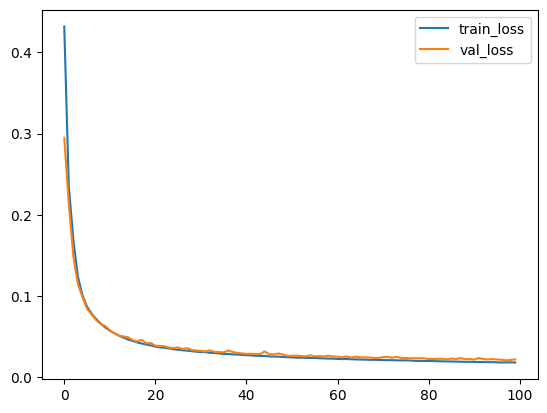

In [15]:
plt.plot(history.history['loss'], label='train_loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.legend(loc='upper right')
plt.show()

In [16]:
predictions = model.predict(X_test_scaled)
predictions_rescaled = scaler_y.inverse_transform(predictions)
mae_FFNN=mean_absolute_error(y_test, predictions_rescaled)
mse_FFNN=mean_squared_error(y_test, predictions_rescaled)

predictions_FFNN_df=pd.DataFrame(predictions_rescaled)
predictions_FFNN_df.columns=y_test.columns

op=pd.DataFrame(predictions_rescaled)
mae_FFNN, mse_FFNN

361/361 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


(0.6128353943801914, 0.7855170771308504)

<h2>Plotting the validation loss and training loss</h2>

<h2>Validation </h2>

In [17]:
predictions_val = model.predict(X_val_scaled)
predictions_rescaled_val = scaler_y.inverse_transform(predictions_val)

mae_FFNN_val=mean_absolute_error(y_val, predictions_rescaled_val)
mse_FFNN_val=mean_squared_error(y_val, predictions_rescaled_val)

predictions_FFNN_df_val=pd.DataFrame(predictions_rescaled_val)
predictions_FFNN_df_val.columns=y_val.columns


1097/1097 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step


<h2>Evaluation metrics for each and every label</h2>

In [18]:
mae_dict_FFNN_val = {}
mse_dict_FFNN_val = {}
for column in predictions_FFNN_df_val.columns:
    mae_val = mean_absolute_error(y_val[column], predictions_FFNN_df_val[column])
    mse_val = mean_squared_error(y_val[column], predictions_FFNN_df_val[column])
    mae_dict_FFNN_val[column] = mae_val
    mse_dict_FFNN_val[column] = mse_val

print("MAE for each column:")
for column, mae_val in mae_dict_FFNN_val.items():
    print(f"{column}: {mae_val}")

print("\nMSE for each column:")
for column, mse_val in mse_dict_FFNN_val.items():
    print(f"{column}: {mse_val}")


MAE for each column:
ERLOP/flow.bc: 2.2607533638543464
HIMOP/flow.bc: 3.699580739899021
HAROP/flow.bc: 3.4946595890974437
STEOP/flow.bc: 1.0746510980973443

MSE for each column:
ERLOP/flow.bc: 12.110927155665353
HIMOP/flow.bc: 53.274459429216606
HAROP/flow.bc: 29.991891325822646
STEOP/flow.bc: 2.2921923056669806


<h1>Linear Regression</h1>

In [19]:
regressor= LinearRegression()
model_linear= regressor.fit(X_val.iloc[:,[-1]],y_val.iloc[:,[1]])
prediction_linear_bonn= regressor.predict(X_val.iloc[:,[-1]]).reshape(-1)

prediction_linear=[prediction_linear_bonn]

mae_val_lin = mean_absolute_error(y_val.iloc[:,[1]], prediction_linear[0])
mse_val_lin = mean_squared_error(y_val.iloc[:,[1]], prediction_linear[0])

<h1>Visualization matplotlib full time</h1>

In [20]:
i=0
data = {
    'Date': y_val.index,
    'Flow observed': np.array(X_val)[:, i+5],
    'MBC FFNN': predictions_rescaled_val[:, i],
    'MBC DA': np.array(y_val)[:, i],
}
df_plot_val = pd.DataFrame(data)
df_plot_val['Random error FFNN'] = df_plot_val['MBC DA'] - df_plot_val['MBC FFNN']


In [21]:


# Create subplots
fig = make_subplots(
    rows=3, cols=1, shared_xaxes=True,
    subplot_titles=(
        'Discharge prediction using FFNN ' + df_output.columns[i],
        'MBC prediction ' + df_output.columns[i],
        'Random error ' + df_output.columns[i]
    ),vertical_spacing=0.05)

#traces for the first subplot
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['Flow observed'],mode='lines',name='Flow observed',legendgroup='1',marker={'color': 'blue'}),row=1, col=1)


#traces for the second subplot
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['MBC FFNN'],mode='lines',name='MBC FFNN',legendgroup='2',marker={'color': 'red'}),row=2, col=1)
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['MBC DA'],mode='lines',name='MBC DA',legendgroup='2',line={'dash': 'dash'},marker={'color': 'blue'}),row=2, col=1)

#traces for the third subplot
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['Random error FFNN'],mode='lines',name=f'Random error FFNN (MAE:{mae_dict_FFNN_val['ERLOP/flow.bc']:.2f}m³/s)',legendgroup='3',marker={'color': 'red'}),row=3, col=1)
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['MBC DA'],mode='lines',name=f'MBC DA (MAE:{df_mae.iloc[0]['ERLOP/flow.bc']:.2f}m³/s)',line={'dash': 'dash'},legendgroup='3',marker={'color': 'blue'}),row=3, col=1)


# Update layout
fig.update_layout(
    height=1100, width=1100,
    template='simple_white',
    xaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    yaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    xaxis2=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    yaxis2=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    xaxis3=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    yaxis3=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    legend_tracegroupgap = 295,
)

fig.update_xaxes(title_text="Date", row=3, col=1)  # Example for updating x-axis label of the third subplot
fig.update_yaxes(title_text="Discharge (m³/s)", row=1, col=1)
fig.update_yaxes(title_text="MBC (m³/s)", row=2, col=1)
fig.update_yaxes(title_text="MBC (m³/s)", row=3, col=1)

fig.show()

<h3>Visualization matplotlib format full time</h3>

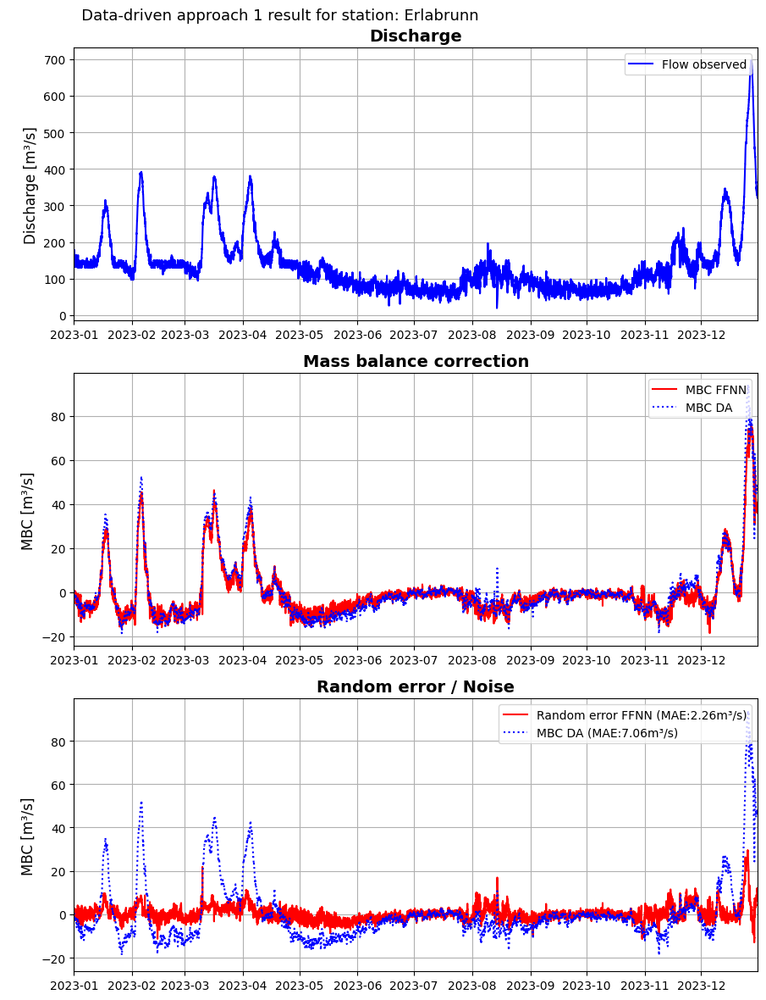

In [22]:
start_date='01/01/2023'
end_date='31/12/2023'

start_date_obj = datetime.strptime(start_date, '%d/%m/%Y')
end_date_obj = datetime.strptime(end_date, '%d/%m/%Y')

fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(9, 12))
fig.suptitle('               Data-driven approach 1 result for station: Erlabrunn', fontsize=13,  x=0.0, ha='left')

ax1.plot(df_plot_val['Date'], df_plot_val['Flow observed'], label='Flow observed', color='Blue')
ax1.set_title('Discharge', fontsize=14, fontweight='bold')
ax1.set_ylabel('Discharge [m³/s]', fontsize=12)
ax1.set_xlim(start_date_obj, end_date_obj)
ax1.grid(True)
ax1.legend(loc='upper right')

ax2.plot(df_plot_val['Date'], df_plot_val['MBC FFNN'], label='MBC FFNN', color='red')
ax2.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label='MBC DA', color='blue', linestyle='dotted')
ax2.set_title('Mass balance correction', fontsize=14, fontweight='bold')
ax2.set_ylabel('MBC [m³/s]', fontsize=12)
ax2.set_xlim(start_date_obj, end_date_obj)
ax2.grid(True)
ax2.legend(loc='upper right')

ax3.plot(df_plot_val['Date'], df_plot_val['Random error FFNN'], label=f'Random error FFNN (MAE:{mae_dict_FFNN_val['ERLOP/flow.bc']:.2f}m³/s)', color='red')
ax3.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label=f'MBC DA (MAE:{df_mae.iloc[0]['ERLOP/flow.bc']:.2f}m³/s)', color='blue', linestyle='dotted')
ax3.set_title('Random error / Noise', fontsize=14, fontweight='bold')
ax3.set_ylabel('MBC [m³/s]', fontsize=12)
ax3.set_xlim(start_date_obj, end_date_obj)
ax3.grid(True)
ax3.legend(loc='upper right')

plt.tight_layout()
plt.savefig('Erlabrunn_Data_driven_approach1_full.png')
plt.show()

In [23]:
i=1
data = {
    'Date': y_val.index,
    'Flow observed': np.array(X_val)[:, i+10],
    'MBC FFNN': predictions_rescaled_val[:, i],
    'MBC DA': np.array(y_val)[:, i],
}
df_plot_val = pd.DataFrame(data)
df_plot_val['Random error FFNN'] = df_plot_val['MBC DA'] - df_plot_val['MBC FFNN']



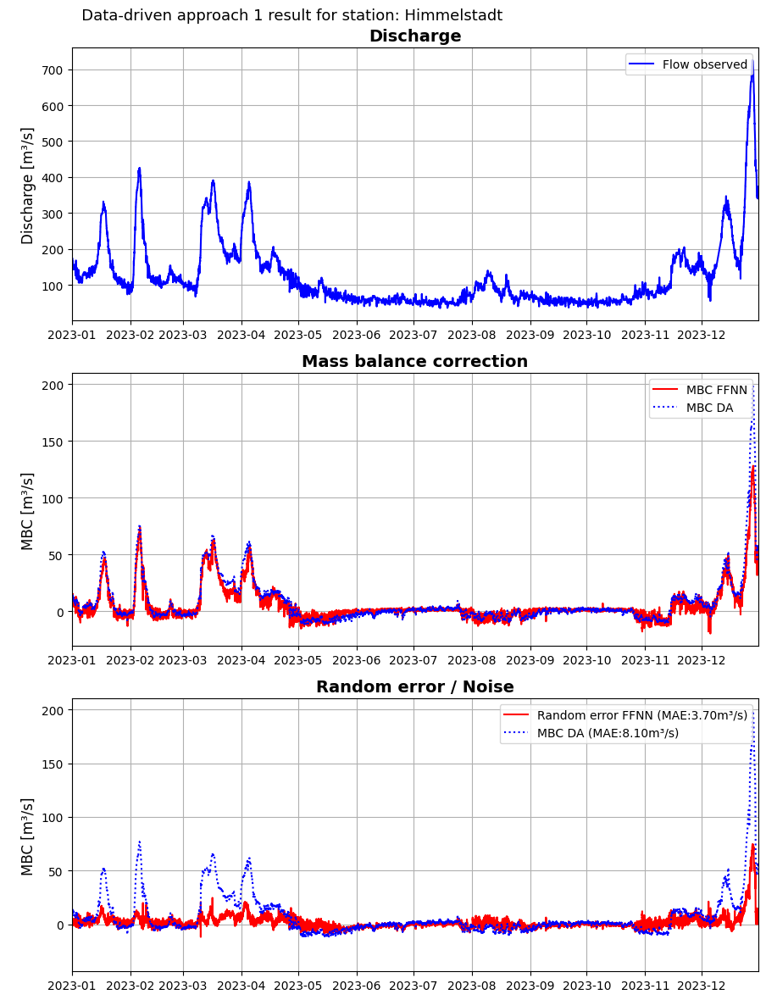

In [24]:


start_date='01/01/2023'
end_date='31/12/2023'

start_date_obj = datetime.strptime(start_date, '%d/%m/%Y')
end_date_obj = datetime.strptime(end_date, '%d/%m/%Y')

fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(9, 12))
fig.suptitle('               Data-driven approach 1 result for station: Himmelstadt', fontsize=13,  x=0.0, ha='left')

ax1.plot(df_plot_val['Date'], df_plot_val['Flow observed'], label='Flow observed', color='Blue')
ax1.set_title('Discharge', fontsize=14, fontweight='bold')
ax1.set_ylabel('Discharge [m³/s]', fontsize=12)
ax1.set_xlim(start_date_obj, end_date_obj)
ax1.grid(True)
ax1.legend(loc='upper right')

ax2.plot(df_plot_val['Date'], df_plot_val['MBC FFNN'], label='MBC FFNN', color='red')
ax2.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label='MBC DA', color='blue', linestyle='dotted')
ax2.set_title('Mass balance correction', fontsize=14, fontweight='bold')
ax2.set_ylabel('MBC [m³/s]', fontsize=12)
ax2.set_xlim(start_date_obj, end_date_obj)
ax2.grid(True)
ax2.legend(loc='upper right')

ax3.plot(df_plot_val['Date'], df_plot_val['Random error FFNN'], label=f'Random error FFNN (MAE:{mae_dict_FFNN_val['HIMOP/flow.bc']:.2f}m³/s)', color='red')
ax3.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label=f'MBC DA (MAE:{df_mae.iloc[0]['HIMOP/flow.bc']:.2f}m³/s)', color='blue', linestyle='dotted')
ax3.set_title('Random error / Noise', fontsize=14, fontweight='bold')
ax3.set_ylabel('MBC [m³/s]', fontsize=12)
ax3.set_xlim(start_date_obj, end_date_obj)
ax3.grid(True)
ax3.legend(loc='upper right')

plt.tight_layout()
plt.savefig('Himmelstadt_Data_driven_approach1_full.png')
plt.show()

In [25]:
i=2
data = {
    'Date': y_val.index,
    'Flow observed': np.array(X_val)[:, i+12],
    'MBC FFNN': predictions_rescaled_val[:, i],
    'MBC DA': np.array(y_val)[:, i],
}
df_plot_val = pd.DataFrame(data)
df_plot_val['Random error FFNN'] = df_plot_val['MBC DA'] - df_plot_val['MBC FFNN']



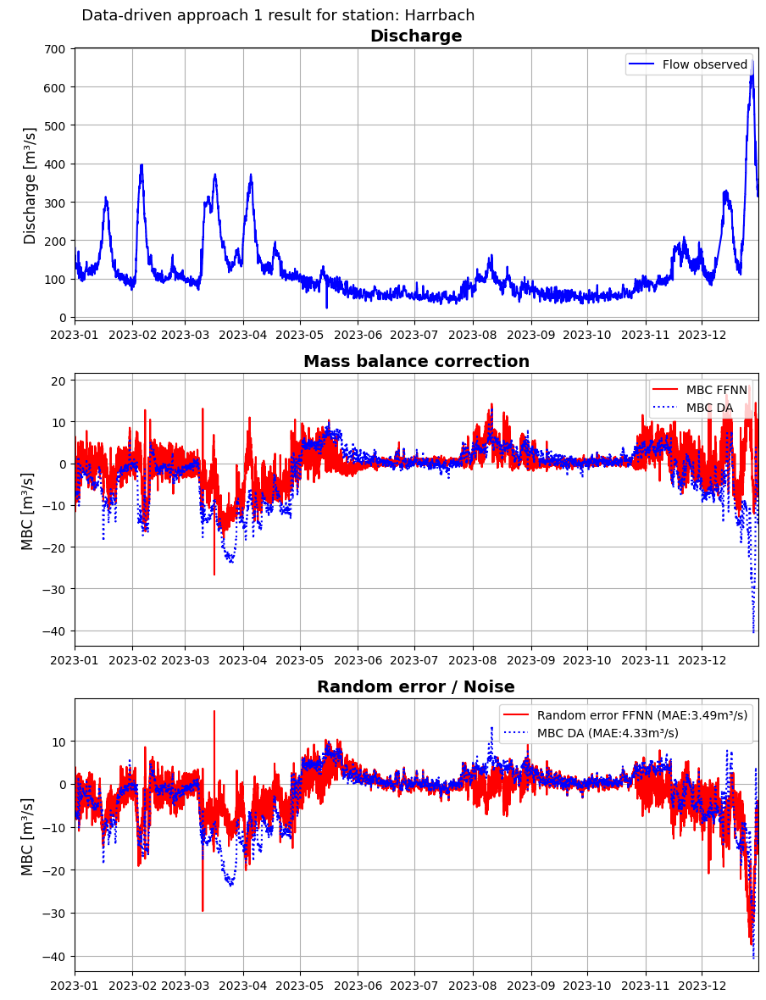

In [26]:


start_date='01/01/2023'
end_date='31/12/2023'

start_date_obj = datetime.strptime(start_date, '%d/%m/%Y')
end_date_obj = datetime.strptime(end_date, '%d/%m/%Y')

fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(9, 12))
fig.suptitle('               Data-driven approach 1 result for station: Harrbach', fontsize=13,  x=0.0, ha='left')

ax1.plot(df_plot_val['Date'], df_plot_val['Flow observed'], label='Flow observed', color='Blue')
ax1.set_title('Discharge', fontsize=14, fontweight='bold')
ax1.set_ylabel('Discharge [m³/s]', fontsize=12)
ax1.set_xlim(start_date_obj, end_date_obj)
ax1.grid(True)
ax1.legend(loc='upper right')

ax2.plot(df_plot_val['Date'], df_plot_val['MBC FFNN'], label='MBC FFNN', color='red')
ax2.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label='MBC DA', color='blue', linestyle='dotted')
ax2.set_title('Mass balance correction', fontsize=14, fontweight='bold')
ax2.set_ylabel('MBC [m³/s]', fontsize=12)
ax2.set_xlim(start_date_obj, end_date_obj)
ax2.grid(True)
ax2.legend(loc='upper right')

ax3.plot(df_plot_val['Date'], df_plot_val['Random error FFNN'], label=f'Random error FFNN (MAE:{mae_dict_FFNN_val['HAROP/flow.bc']:.2f}m³/s)', color='red')
ax3.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label=f'MBC DA (MAE:{df_mae.iloc[0]['HAROP/flow.bc']:.2f}m³/s)', color='blue', linestyle='dotted')
ax3.set_title('Random error / Noise', fontsize=14, fontweight='bold')
ax3.set_ylabel('MBC [m³/s]', fontsize=12)
ax3.set_xlim(start_date_obj, end_date_obj)
ax3.grid(True)
ax3.legend(loc='upper right')

plt.tight_layout()
plt.savefig('Harrbach_Data_driven_approach1_full.png')
plt.show()

In [27]:
i=3
data = {
    'Date': y_val.index,
    'Flow observed': np.array(X_val)[:, i+16],
    'MBC FFNN': predictions_rescaled_val[:, i],
    'MBC DA': np.array(y_val)[:, i],
}
df_plot_val = pd.DataFrame(data)
df_plot_val['Random error FFNN'] = df_plot_val['MBC DA'] - df_plot_val['MBC FFNN']



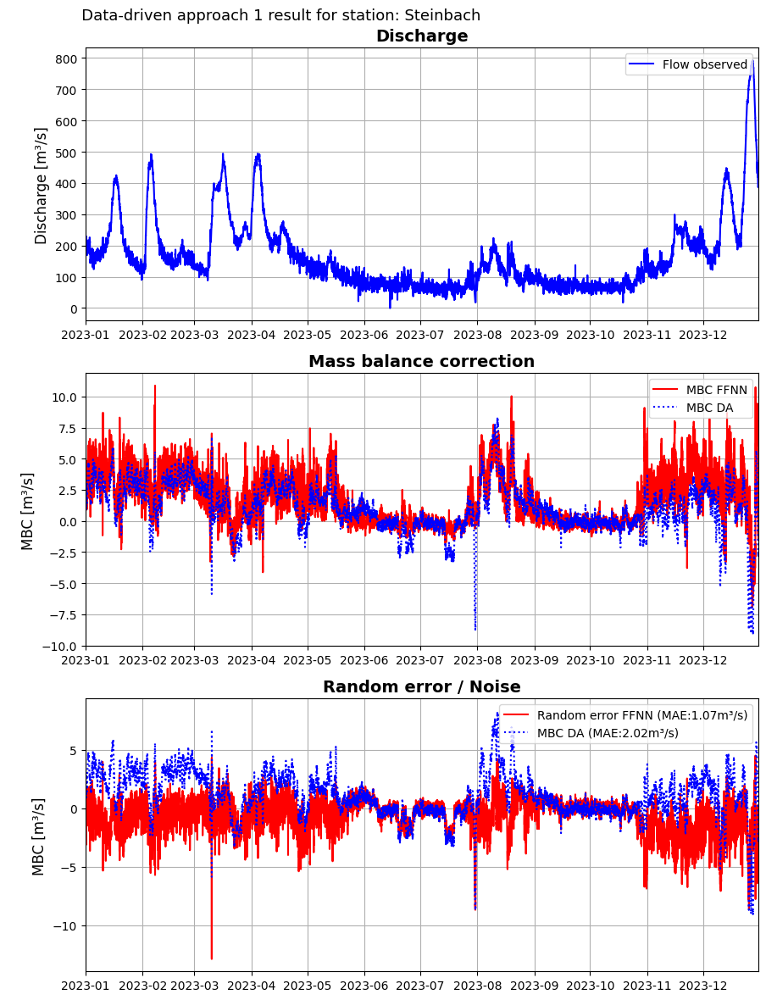

In [28]:


start_date='01/01/2023'
end_date='31/12/2023'

start_date_obj = datetime.strptime(start_date, '%d/%m/%Y')
end_date_obj = datetime.strptime(end_date, '%d/%m/%Y')

fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(9, 12))
fig.suptitle('               Data-driven approach 1 result for station: Steinbach', fontsize=13,  x=0.0, ha='left')

ax1.plot(df_plot_val['Date'], df_plot_val['Flow observed'], label='Flow observed', color='Blue')
ax1.set_title('Discharge', fontsize=14, fontweight='bold')
ax1.set_ylabel('Discharge [m³/s]', fontsize=12)
ax1.set_xlim(start_date_obj, end_date_obj)
ax1.grid(True)
ax1.legend(loc='upper right')

ax2.plot(df_plot_val['Date'], df_plot_val['MBC FFNN'], label='MBC FFNN', color='red')
ax2.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label='MBC DA', color='blue', linestyle='dotted')
ax2.set_title('Mass balance correction', fontsize=14, fontweight='bold')
ax2.set_ylabel('MBC [m³/s]', fontsize=12)
ax2.set_xlim(start_date_obj, end_date_obj)
ax2.grid(True)
ax2.legend(loc='upper right')

ax3.plot(df_plot_val['Date'], df_plot_val['Random error FFNN'], label=f'Random error FFNN (MAE:{mae_dict_FFNN_val['STEOP/flow.bc']:.2f}m³/s)', color='red')
ax3.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label=f'MBC DA (MAE:{df_mae.iloc[0]['STEOP/flow.bc']:.2f}m³/s)', color='blue', linestyle='dotted')
ax3.set_title('Random error / Noise', fontsize=14, fontweight='bold')
ax3.set_ylabel('MBC [m³/s]', fontsize=12)
ax3.set_xlim(start_date_obj, end_date_obj)
ax3.grid(True)
ax3.legend(loc='upper right')

plt.tight_layout()
plt.savefig('Steinbach_Data_driven_approach1_full.png')
plt.show()

<h3>Visualization matplotlib format limilted time</h3>

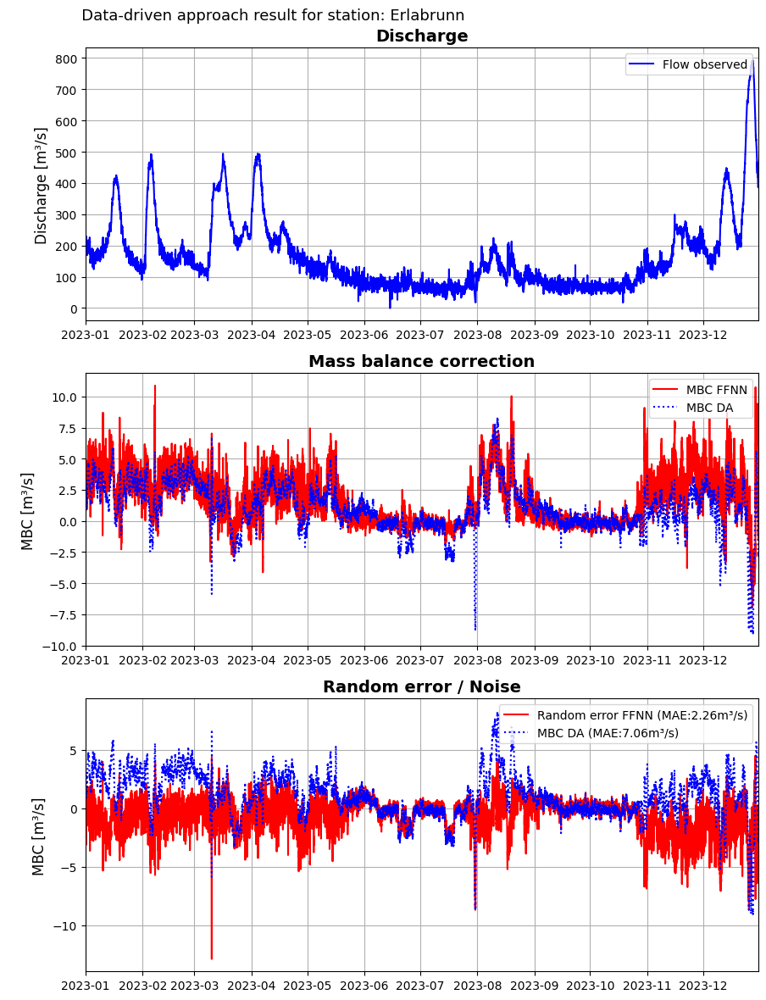

In [29]:
start_date='01/01/2023'
end_date='31/12/2023'

start_date_obj = datetime.strptime(start_date, '%d/%m/%Y')
end_date_obj = datetime.strptime(end_date, '%d/%m/%Y')

fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(9, 12))
fig.suptitle('               Data-driven approach result for station: Erlabrunn', fontsize=13,  x=0.0, ha='left')

ax1.plot(df_plot_val['Date'], df_plot_val['Flow observed'], label='Flow observed', color='Blue')
ax1.set_title('Discharge', fontsize=14, fontweight='bold')
ax1.set_ylabel('Discharge [m³/s]', fontsize=12)
ax1.set_xlim(start_date_obj, end_date_obj)
ax1.grid(True)
ax1.legend(loc='upper right')

ax2.plot(df_plot_val['Date'], df_plot_val['MBC FFNN'], label='MBC FFNN', color='red')
ax2.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label='MBC DA', color='blue', linestyle='dotted')
ax2.set_title('Mass balance correction', fontsize=14, fontweight='bold')
ax2.set_ylabel('MBC [m³/s]', fontsize=12)
ax2.set_xlim(start_date_obj, end_date_obj)
ax2.grid(True)
ax2.legend(loc='upper right')

ax3.plot(df_plot_val['Date'], df_plot_val['Random error FFNN'], label=f'Random error FFNN (MAE:{mae_dict_FFNN_val['ERLOP/flow.bc']:.2f}m³/s)', color='red')
ax3.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label=f'MBC DA (MAE:{df_mae.iloc[0]['ERLOP/flow.bc']:.2f}m³/s)', color='blue', linestyle='dotted')
ax3.set_title('Random error / Noise', fontsize=14, fontweight='bold')
ax3.set_ylabel('MBC [m³/s]', fontsize=12)
ax3.set_xlim(start_date_obj, end_date_obj)
ax3.grid(True)
ax3.legend(loc='upper right')

plt.tight_layout()
plt.savefig('Erlabrunn_Data_driven_approach1_limited.png')
plt.show()

<h1>Visualization matplotlib format collection subplots</h1>

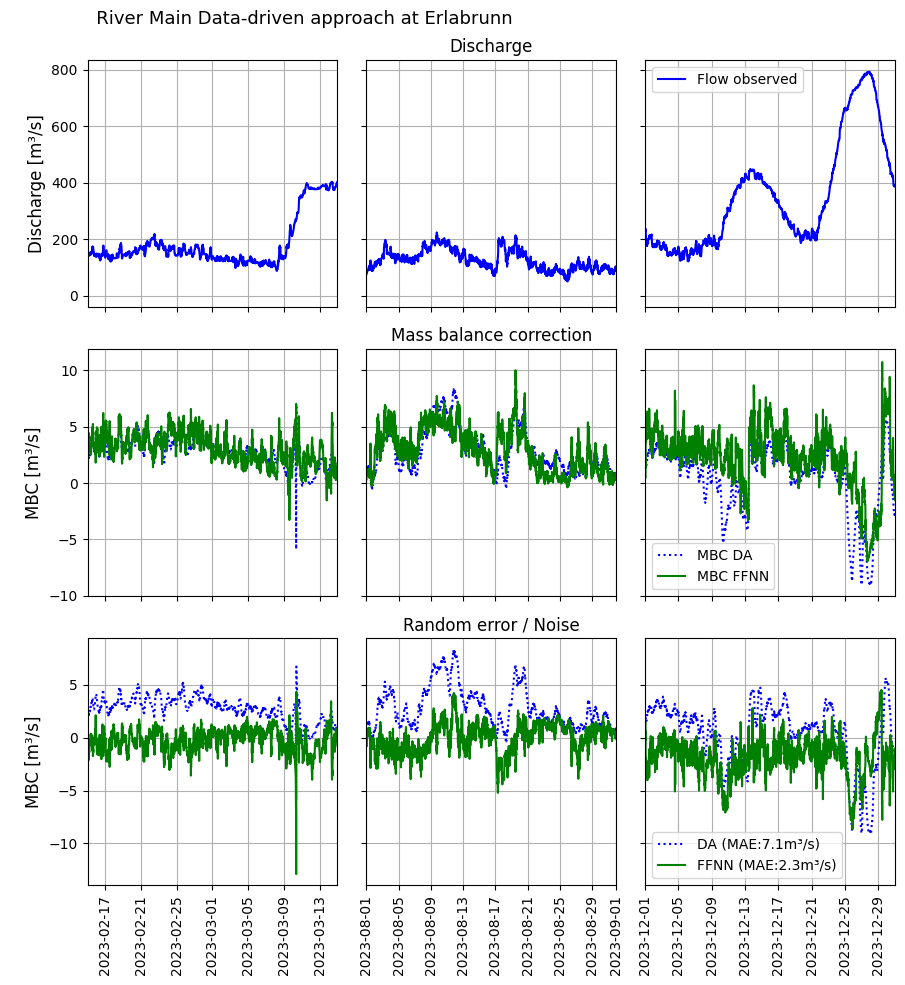

In [30]:
fig, ((ax1, ax4, ax7),(ax2, ax5, ax8),(ax3, ax6, ax9)) = plt.subplots(3, 3, figsize=(9, 10))
fig.suptitle('               River Main Data-driven approach at Erlabrunn', fontsize=13,  x=0.0, ha='left')

start_date='15/02/2023'
end_date='15/03/2023'
start_date_obj = datetime.strptime(start_date, '%d/%m/%Y')
end_date_obj = datetime.strptime(end_date, '%d/%m/%Y')

ax1.plot(df_plot_val['Date'], df_plot_val['Flow observed'], label='Flow observed', color='Blue')
ax1.set_ylabel('Discharge [m³/s]', fontsize=12)
ax1.set_xlim(start_date_obj, end_date_obj)
ax1.set_xticklabels([])
ax1.grid()

ax2.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label='MBC DA', color='blue', linestyle='dotted')
ax2.plot(df_plot_val['Date'], df_plot_val['MBC FFNN'], label='MBC FFNN', color='green')
ax2.set_ylabel('MBC [m³/s]', fontsize=12)
ax2.set_xlim(start_date_obj, end_date_obj)
ax2.set_xticklabels([])
ax2.grid()

ax3.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label=f'MBC DA (MAE:{df_mae.iloc[0]['ERLOP/flow.bc']:.2f}m³/s)', color='blue', linestyle='dotted')
ax3.plot(df_plot_val['Date'], df_plot_val['Random error FFNN'], label=f'Random error FFNN (MAE:{mae_dict_FFNN_val['ERLOP/flow.bc']:.2f}m³/s)', color='green')
ax3.set_ylabel('MBC [m³/s]', fontsize=12)
ax3.set_xlim(start_date_obj, end_date_obj)
ax3.grid()
ax3.tick_params(axis='x', labelrotation=90)

start_date='01/08/2023'
end_date='01/09/2023'
start_date_obj = datetime.strptime(start_date, '%d/%m/%Y')
end_date_obj = datetime.strptime(end_date, '%d/%m/%Y')

ax4.plot(df_plot_val['Date'], df_plot_val['Flow observed'], label='Flow observed', color='Blue')
ax4.set_title('Discharge', fontsize=12)
ax4.set_xlim(start_date_obj, end_date_obj)
ax4.set_xticklabels([])
ax4.set_yticklabels([])
ax4.grid()

ax5.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label='MBC DA', color='blue', linestyle='dotted')
ax5.plot(df_plot_val['Date'], df_plot_val['MBC FFNN'], label='MBC FFNN', color='green')
ax5.set_title('Mass balance correction', fontsize=12)
ax5.set_xlim(start_date_obj, end_date_obj)
ax5.set_xticklabels([])
ax5.set_yticklabels([])
ax5.grid()

ax6.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label=f'MBC DA (MAE:{df_mae.iloc[0]['ERLOP/flow.bc']:.2f}m³/s)', color='blue', linestyle='dotted')
ax6.plot(df_plot_val['Date'], df_plot_val['Random error FFNN'], label=f'Random error FFNN (MAE:{mae_dict_FFNN_val['ERLOP/flow.bc']:.2f}m³/s)', color='green')
ax6.set_title('Random error / Noise', fontsize=12)
ax6.set_xlim(start_date_obj, end_date_obj)
ax6.grid()
ax6.set_yticklabels([])
ax6.tick_params(axis='x', labelrotation=90)

start_date='01/12/2023'
end_date='31/12/2023'
start_date_obj = datetime.strptime(start_date, '%d/%m/%Y')
end_date_obj = datetime.strptime(end_date, '%d/%m/%Y')

ax7.plot(df_plot_val['Date'], df_plot_val['Flow observed'], label='Flow observed', color='Blue')
ax7.set_xlim(start_date_obj, end_date_obj)
ax7.set_xticklabels([])
ax7.set_yticklabels([])
ax7.grid()
ax7.legend()

ax8.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label='MBC DA', color='blue', linestyle='dotted')
ax8.plot(df_plot_val['Date'], df_plot_val['MBC FFNN'], label='MBC FFNN', color='green')
ax8.set_xlim(start_date_obj, end_date_obj)
ax8.set_xticklabels([])
ax8.set_yticklabels([])
ax8.grid()
ax8.legend()

ax9.plot(df_plot_val['Date'], df_plot_val['MBC DA'], label=f'DA (MAE:{df_mae.iloc[0]['ERLOP/flow.bc']:.1f}m³/s)', color='blue', linestyle='dotted')
ax9.plot(df_plot_val['Date'], df_plot_val['Random error FFNN'], label=f'FFNN (MAE:{mae_dict_FFNN_val['ERLOP/flow.bc']:.1f}m³/s)', color='green')
ax9.set_xlim(start_date_obj, end_date_obj)
ax9.grid()

ax9.set_yticklabels([])
ax9.legend()
ax9.tick_params(axis='x', labelrotation=90)

# for ax in fig.get_axes():
#     ax.label_outer()

plt.tight_layout()
plt.savefig('01_Erlabrunn_extremes_time.png')
plt.show()


<h2> Himmelstadt Output visualization</h2>

In [31]:
i=2
data = {
    'Date': y_val.index,
    'Flow observed': np.array(y_val)[:, 2],
    'Flow predicted': predictions_rescaled_val[:, 2],
    'MBC FFNN': predictions_rescaled_val[:, 3],
    'MBC DA': np.array(y_val)[:, 3],
}


In [32]:
df_plot_val = pd.DataFrame(data)
df_plot_val['Random error FFNN'] = df_plot_val['MBC DA'] - df_plot_val['MBC FFNN']

# Create subplots
fig = make_subplots(
    rows=3, cols=1, shared_xaxes=True,
    subplot_titles=(
        'Discharge prediction using FFNN ' + df_output.columns[i],
        'MBC prediction ' + df_output.columns[i],
        'Random error ' + df_output.columns[i]
    ),vertical_spacing=0.05)

#traces for the first subplot
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['Flow observed'],mode='lines',name='Flow observed',legendgroup='1',line={'dash': 'dash'},marker={'color': 'blue'}),row=1, col=1)
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['Flow observed'],mode='lines',name='Flow predicted',legendgroup='1',marker={'color': 'red'}),row=1, col=1)

#traces for the second subplot
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['MBC FFNN'],mode='lines',name='MBC FFNN',legendgroup='2',marker={'color': 'red'}),row=2, col=1)
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['MBC DA'],mode='lines',name='MBC DA',legendgroup='2',line={'dash': 'dash'},marker={'color': 'blue'}),row=2, col=1)

#traces for the third subplot
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['Random error FFNN'],mode='lines',name=f'Random error FFNN (MAE:{mae_dict_FFNN_val['HIMOP/flow.bc']:.2f}m³/s)',legendgroup='3',marker={'color': 'red'}),row=3, col=1)
fig.append_trace(go.Scatter(x=df_plot_val['Date'],y=df_plot_val['MBC DA'],mode='lines',name=f'MBC DA (MAE:{df_mae.iloc[0]['HIMOP/flow.bc']:.2f}m³/s)',line={'dash': 'dash'},legendgroup='3',marker={'color': 'blue'}),row=3, col=1)


# Update layout
fig.update_layout(
    height=1100, width=1100,
    template='simple_white',
    xaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    yaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    xaxis2=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    yaxis2=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    xaxis3=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    yaxis3=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    legend_tracegroupgap = 295,
)

fig.update_xaxes(title_text="Date", row=3, col=1)  # Example for updating x-axis label of the third subplot
fig.update_yaxes(title_text="Discharge (m³/s)", row=1, col=1)
fig.update_yaxes(title_text="MBC (m³/s)", row=2, col=1)
fig.update_yaxes(title_text="MBC (m³/s)", row=3, col=1)

fig.show()

<h1>Visualization matplotlib format collection subplots</h1>